## Comparing the wordclouds for two different word vectorization methods.

#### Topics

1.0 Importing packages and loading data

    1.1 Exploratory Data Analysis (EDA)

2.0 Cleaning text for analysis

    2.1 Decoding
    
    2.2 Cleaning the text 

3.0 Plotting the wordcloud - Review Body

    3.1 Count Vectorizer
    
    3.2 TfIdf Vectorizer
    
    3.3 Result

4.0 Plotting the wordcloud - Review Headline

    4.1 Count Vectorizer
    
    4.2 TfIdf Vectorizer
    
    4.3 Result

5.0 Interpreting the results

## 1.0 Importing packages and loading data

Import all the packages and load the required data downloaded using tensorflow_datasets.

In [1]:
# required libraries
import tensorflow
import tensorflow_datasets as tfds
from textblob import TextBlob
import nltk
import re
from nltk.corpus import stopwords
import numpy as np
import pandas as pd
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import metrics
from wordcloud import WordCloud
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
# download the dataset from tensorflow, one its downloaded it will be stored in your local directory making it easy accessible
ds_watch = tfds.load('amazon_us_reviews/Watches_v1_00', split='train', shuffle_files= True)

In [3]:
# load dataset zhvi_all_homes downloaded from tensorflow_datasets
df_watch = tfds.as_dataframe(ds_watch.take(10000))
# display the dataframe
df_watch

data/customer_id  data/helpful_votes data/marketplace  \
0         b'24552367'                  18            b'US'   
1          b'5583126'                   0            b'US'   
2           b'351381'                   0            b'US'   
3         b'35766969'                   0            b'US'   
4         b'12610753'                   0            b'US'   
...               ...                 ...              ...   
9995      b'22386856'                   2            b'US'   
9996      b'15372435'                   1            b'US'   
9997      b'45885442'                  23            b'US'   
9998       b'7565844'                   1            b'US'   
9999      b'34196053'                   2            b'US'   

     data/product_category data/product_id data/product_parent  \
0               b'Watches'   b'B008BWM6SS'        b'133474662'   
1               b'Watches'   b'B00BJF5SB6'        b'265047010'   
2               b'Watches'   b'B00134N5IQ'        b'912420964'   
3               b'Watches'   b'B00132YJGK'        b'580856743'   
4               b'Watches'   b'B007BD0XLA'        b'788744979'   
...                    ...             ...                 ...   
9995            b'Watches'   b'B003OQ6EWA'         b'24894395'   
9996            b'Watches'   b'B000WUCIF8'        b'530889672'   
9997            b'Watches'   b'B000SZPZV6'        b'750997314'   
9998            b'Watches'   b'B005IGOWH8'        b'144776453'   
9999            b'Watches'   b'B001QFZWW4'        b'177808285'   

                                     data/product_title  \
0     b'ShoppeWatch Elegant Plane Style Digital Disp...   
1      b'BIAOQI Automatic Mechanical Leather Men Watch'   
2         b"Casio Men's AQ47-1E Classic Ana-Digi Watch"   
3     b"Stuhrling Original Men's 150A.33152 Symphony...   
4     b"Swiss Military Calibre Men's 06-4C2-04-007T ...   
...                                                 ...   
9995  b"Timex Women's Q7B756 Two-Tone Stainless Stee...   
9996                     b"Guess Women's Watch G85850L"   
9997              b'Timex Kids My First Outdoors Watch'   
9998  b'Tokyobay WATCH TRAM STITCH TURQUOISE BLUE Un...   
9999  b"Invicta Women's 5377 Angel Diamond-Accented ...   

                                       data/review_body data/review_date  \
0     b"This is a great looking watch. Very unique. ...    b'2012-08-15'   
1     b"They were great with costumer service. I hav...    b'2013-03-18'   
2     b'this is the greatest watch.light weight, eas...    b'2015-03-16'   
3     b'I received this Stuhrling watch from my wife...    b'2009-06-09'   
4     b'Saw the watch and a great price and liked it...    b'2014-01-03'   
...                                                 ...              ...   
9995  b"This is a very good watch band.  If you don'...    b'2015-03-02'   
9996  b"She loved it!  Unique design - don't see man...    b'2013-02-12'   
9997  b'Bought this for my 8 year old son. This one ...    b'2010-01-08'   
9998  b"This watch - look overall not bad. BUT !!! T...    b'2014-08-08'   
9999  b"I'd been looking at this for so long; then m...    b'2013-04-18'   

                                  data/review_headline     data/review_id  \
0                                 b'pretty good watch'  b'R2EXC01XGUJ0RN'   
1                                    b'Resent & fixed'   b'RBO9BMF12Y0WR'   
2                                        b'Five Stars'  b'R2VVCKV2FO1H4E'   
3                               b'Beautiful Timepiece'  b'R3R2N36G78GJ9Z'   
4                               b'Got what I paid for'  b'R3GJPV0PRDU1WY'   
...                                                ...                ...   
9995                            b'Timeless Timex Band'  b'R2R423L3V5KNRG'   
9996                              b'Guess Round Watch'   b'RXNJMF7BJSOWW'   
9997                         b'Adult-style kids watch'  b'R16PC6XIYA2AFX'   
9998  b"It's not worth the money - price is too high!"    b'RKUXUJRDEWG1'  

In [4]:
# display the columns
df_watch.columns

Index(['data/customer_id', 'data/helpful_votes', 'data/marketplace',
       'data/product_category', 'data/product_id', 'data/product_parent',
       'data/product_title', 'data/review_body', 'data/review_date',
       'data/review_headline', 'data/review_id', 'data/star_rating',
       'data/total_votes', 'data/verified_purchase', 'data/vine'],
      dtype='object')

### 1.1 Exploratory Data Analysis (EDA)

Create a new dataframe with the columns of our interest that are review_body, review_headline for doing sentimental analysis. Taking the stra_rating will help in training our model using a supervised learning.

In [5]:
df_watch_new = df_watch[['data/review_body', 'data/review_headline', 'data/star_rating']]
df_watch_new

,data/review_body,data/review_headline,data/star_rating
0,"b""This is a great looking watch. Very unique. ...",b'pretty good watch',4
1,"b""They were great with costumer service. I hav...",b'Resent & fixed',5
2,"b'this is the greatest watch.light weight, eas...",b'Five Stars',5
3,b'I received this Stuhrling watch from my wife...,b'Beautiful Timepiece',5
4,b'Saw the watch and a great price and liked it...,b'Got what I paid for',5
...,...,...,...
9995,"b""This is a very good watch band. If you don'...",b'Timeless Timex Band',4
9996,"b""She loved it! Unique design - don't see man...",b'Guess Round Watch',5
9997,b'Bought this for my 8 year old son. This one ...,b'Adult-style kids watch',5
9998,"b""This watch - look overall not bad. BUT !!! T...","b""It's not worth the money - price is too high!""",1


#### Null Values

Perform a null value check on the dataframe.

In [6]:
df_watch_new.isnull().sum()

data/review_body        0
data/review_headline    0
data/star_rating        0
dtype: int64

#### Outlier detection

We have drawn a boxplot to see how many values are lying as outlier(above upper whisker and lower whisker).

C:\Users\home\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='data/star_rating'>

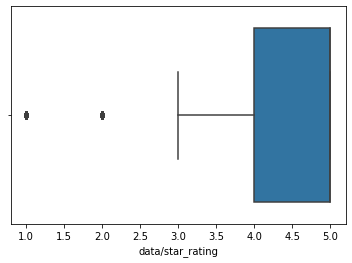

In [7]:
sns.boxplot(df_watch_new["data/star_rating"])

Detecting the outlier can be checked using below quantile method.

In [8]:
q1 = df_watch_new["data/star_rating"].quantile(0.25)
q3 = df_watch_new["data/star_rating"].quantile(0.75)
q1, q3

(4.0, 5.0)

In [9]:
iqr = q3-q1
iqr

1.0

In [10]:
upper = q3 +1.5*iqr
lower = q1 - 1.5*iqr
upper, lower

(6.5, 2.5)

In [11]:
df_watch_new.quantile(0.1)

data/star_rating    2.0
Name: 0.1, dtype: float64

Outliers can be seen but this is due to the dataset being not completely ditributed, the first 10K rows of data if we see it contains 5800 with rating 5, 1800 with rating 4, 850 with rating 3 & 1 and 500 with rating 2. Due to this most of the weight of the ratings is above 3 making 1 & 2 as outliers.

In [12]:
for i in df_watch_new["data/star_rating"].unique():
    print("Rating: ", i, ", Count: ", df_watch_new[df_watch_new["data/star_rating"] == i].shape[0])

Rating:  4 , Count:  1818
Rating:  5 , Count:  5875
Rating:  1 , Count:  890
Rating:  3 , Count:  863
Rating:  2 , Count:  554


## 2.0 Cleaning text for analysis

### 2.1 Decoding
All the text data present in the dataframe is encoded in a utf8 format, before starting any processing on the text we need to decode it.


In [13]:
# https://stackoverflow.com/questions/40389764/how-to-translate-bytes-objects-into-literal-strings-in-pandas-dataframe-pytho
df_watch_new['data/review_body'] = df_watch_new['data/review_body'].str.decode("utf-8")
df_watch_new['data/review_headline'] = df_watch_new['data/review_headline'].str.decode("utf-8")
df_watch_new

<ipython-input-13-8b3deca557e8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_watch_new['data/review_body'] = df_watch_new['data/review_body'].str.decode("utf-8")
<ipython-input-13-8b3deca557e8>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_watch_new['data/review_headline'] = df_watch_new['data/review_headline'].str.decode("utf-8")


,data/review_body,data/review_headline,data/star_rating
0,This is a great looking watch. Very unique. No...,pretty good watch,4
1,They were great with costumer service. I have ...,Resent & fixed,5
2,"this is the greatest watch.light weight, easy ...",Five Stars,5
3,I received this Stuhrling watch from my wife a...,Beautiful Timepiece,5
4,Saw the watch and a great price and liked it.....,Got what I paid for,5
...,...,...,...
9995,This is a very good watch band. If you don't ...,Timeless Timex Band,4
9996,She loved it! Unique design - don't see many ...,Guess Round Watch,5
9997,Bought this for my 8 year old son. This one se...,Adult-style kids watch,5
9998,This watch - look overall not bad. BUT !!! The...,It's not worth the money - price is too high!,1


#### Contractions

We didnt want to lose the meaning of some sentneces if we do sentiment analysis, thats the reason we have added the contractions to expand it for better analysis.

In [14]:
contractions = { 
"ain't": "am not",
"aren't": "are not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he would",
"he'd've": "he would have",
"he'll": "he will",
"he's": "he is",
"how'd": "how did",
"how'll": "how will",
"how's": "how is",
"i'd": "i would",
"i'll": "i will",
"i'm": "i am",
"i've": "i have",
"isn't": "is not",
"it'd": "it would",
"it'll": "it will",
"it's": "it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"must've": "must have",
"mustn't": "must not",
"needn't": "need not",
"oughtn't": "ought not",
"shan't": "shall not",
"sha'n't": "shall not",
"she'd": "she would",
"she'll": "she will",
"she's": "she is",
"should've": "should have",
"shouldn't": "should not",
"that'd": "that would",
"that's": "that is",
"there'd": "there had",
"there's": "there is",
"they'd": "they would",
"they'll": "they will",
"they're": "they are",
"they've": "they have",
"wasn't": "was not",
"we'd": "we would",
"we'll": "we will",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what will",
"what're": "what are",
"what's": "what is",
"what've": "what have",
"where'd": "where did",
"where's": "where is",
"who'll": "who will",
"who's": "who is",
"won't": "will not",
"wouldn't": "would not",
"you'd": "you would",
"you'll": "you will",
"you're": "you are"
}

### 2.2 Cleaning the text

All the important steps of cleaning the text are performed in the API clean_text.

1. Lower the text
2. Replace the contractions
3. Cleaning the words to remove unwanted characters(important step)
4. Stop words removal
5. Remove lengthening of words
6. Perform Lemmatization
7. Perform stemming

In [15]:
def clean_text(text, remove_stopwords = True):
    '''Remove unwanted characters, stopwords, and format the text to create fewer nulls word embeddings'''
    
    # Convert words to lower case
    text = text.lower()
    
    # Replace contractions with their longer forms 
    if True:
        text = text.split()
        new_text = []
        for word in text:
            if word in contractions:
                new_text.append(contractions[word])
            else:
                new_text.append(word)
        text = " ".join(new_text)
    
    # Format words and remove unwanted characters
    text = re.sub(r'https?:\/\/.*[\r\n]*', ' ', text, flags=re.MULTILINE)
    text = re.sub(r'\<a href', ' ', text)
    text = re.sub(r'&amp;', ' ', text) 
    text = re.sub(r'[_"\-;%()|+&=*%.,!?:#$@\[\]/]', ' ', text)
    # <br and > have been done separately because they are getting treated as different words rather than a single tag
    text = re.sub(r'<br ', ' ', text)
    text = re.sub(r'>', ' ', text)
    text = re.sub(r'\'', ' ', text)
    text = re.sub(r'\\\\', ' ', text)
    text = re.sub(r'<p><br [\/]?><[\/]?p>', ' ', text)
    text = re.sub(r'\d+', '', text)
    text = re.sub("[^a-zA-Z]+", " ",text)
    
    
    # Optionally, remove stop words
    if remove_stopwords:
        text = text.split()
        stops = set(stopwords.words('english'))
        text = [w for w in text if not w in stops]
    
    # Remove Lengthening
    patt = re.compile(r"(.)\1{2,}")
    length_list = [patt.sub(r"\1",word) for word in text]
    
    # Lemmatizer
    lem = WordNetLemmatizer()
    lem_list = [lem.lemmatize(word) for word in length_list]
    
    # Stemming
    porter = PorterStemmer()
    stem_list = [porter.stem(word) for word in lem_list]
    stem_list = list(dict.fromkeys(stem_list))
    text = " ".join(stem_list)
    
    return text

Calling the above API for each row and adding it to a clean_review list for further analysis.

In [16]:
clean_review = []
for i in df_watch_new['data/review_body']:
    clean_review.append(clean_text(i))
clean_review

['great look watch uniqu mani problem especi price point cant go wrong thing like know happen run littl fast mean set time soon took box next day alreadi minut ahead occasion everi cool paint start come everyth still work fine overal recommend',
 'great costum servic difficulti get packag sent address regist gp mail product back contact resent make sure receiv busi',
 'greatest watch light weight easi read thin wear',
 'receiv stuhrl watch wife birthday present nice beauti look good hand eventhough dial bigger normal perfectli fit lot compliment last one month absolutli love',
 'saw watch great price like bought get new batteri ok',
 'cheap chic',
 'bought watch use someon amazon thought might provid inform short think pretti awesom coolest featur cours transform three hand larg perpetu date chronograph central second minut hour plu th indic difficult find make read dead simpl actual like easi intuit analog readout quit possibl best could buy function enabl five independ bi direct moto

## 3.0 Plotting the wordcloud - Review body

1. Count vectorizer
2. Tfidf Vectorizer

### 3.1 Count Vecotizer

It gives 1 to the word if it is present in the senetence and 0 if not present and creates a 2D matrix with column names as words across all the documents with index as the senetence.

In [17]:
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(clean_review)
column_names = vectorizer.get_feature_names()
df1 = pd.DataFrame(X.toarray(), columns = column_names, index = clean_review)
df1

,aa,aabout,aacut,aato,abandon,abbrevi,abc,abid,abil,abit,...,zippo,zirconia,zize,zombi,zon,zone,zoo,zootsuit,zuedel,zulu
great look watch uniqu mani problem especi price point cant go wrong thing like know happen run littl fast mean set time soon took box next day alreadi minut ahead occasion everi cool paint start come everyth still work fine overal recommend,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
great costum servic difficulti get packag sent address regist gp mail product back contact resent make sure receiv busi,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
greatest watch light weight easi read thin wear,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
receiv stuhrl watch wife birthday present nice beauti look good hand eventhough dial bigger normal perfectli fit lot compliment last one month absolutli love,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
saw watch great price like bought get new batteri ok,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
good watch band special tool chang difficult finger larg struggl quick took minut least complet look brand new way timex year old batteri,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
love uniqu design see mani like even keep time gray blacvk go well outfit,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
bought year old son one seem rug cartoon theme water resist meter taken inevit fall bicycl footbal hit frisbe basebal casual toss around boy well get idea believ money save action hero licens gone make better watch like adult style dad real also realli velcro band found roll leather tip match curv wrist help end stick smallish near case thu catch thing look price batteri replac necessari unless stop restor trust timex time,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
watch look overal bad seriou object put arrow comfort conveni time lamb small lot le cheap import sweat hand today work hour stage concert led dial becam turbid see anyth chaskh accumul condens worth zheneg price clearli high best option pleas save money,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


cosine_similarity is used in finding the similarity for 1 sentence against all the others.

In [18]:
cosine_similarity(df1)

array([[1.        , 0.03539962, 0.05455447, ..., 0.10835905, 0.14118624,
        0.07079923],
       [0.03539962, 1.        , 0.        , ..., 0.05370216, 0.        ,
        0.05263158],
       [0.05455447, 0.        , 1.        , ..., 0.04138029, 0.05391639,
        0.08111071],
       ...,
       [0.10835905, 0.05370216, 0.04138029, ..., 1.        , 0.10709165,
        0.1342554 ],
       [0.14118624, 0.        , 0.05391639, ..., 0.10709165, 1.        ,
        0.06997114],
       [0.07079923, 0.05263158, 0.08111071, ..., 0.1342554 , 0.06997114,
        1.        ]])

Below code get_feature helps us in extracting all the words in the corpus with a count associated with it.

In [19]:
def get_feature(X, column_names):
    X_mat = X.toarray()
    docs = X_mat[(X_mat>0).any(axis=1)]
    words = np.array(column_names)
    frequencies={}
    for i in range(len(docs)):
        doc = docs[i] 
        idx = (doc>0)
        doc_words = words[idx]
        doc_counts = doc[doc>0]
        dict1 = dict(zip(doc_words, doc_counts))
        frequencies.update(dict1)
    return frequencies

In [20]:
frequencies_review = get_feature(X, column_names)
frequencies_review

{'ahead': 1,
 'alreadi': 1,
 'box': 1,
 'cant': 1,
 'come': 1,
 'cool': 1,
 'day': 1,
 'especi': 1,
 'everi': 1,
 'everyth': 1,
 'fast': 1,
 'fine': 1,
 'go': 1,
 'great': 1,
 'happen': 1,
 'know': 1,
 'like': 1,
 'littl': 1,
 'look': 1,
 'mani': 1,
 'mean': 1,
 'minut': 1,
 'next': 1,
 'occasion': 1,
 'overal': 1,
 'paint': 1,
 'point': 1,
 'price': 1,
 'problem': 1,
 'recommend': 1,
 'run': 1,
 'set': 1,
 'soon': 1,
 'start': 1,
 'still': 1,
 'thing': 1,
 'time': 1,
 'took': 1,
 'uniqu': 1,
 'watch': 1,
 'work': 1,
 'wrong': 1,
 'address': 1,
 'back': 1,
 'busi': 1,
 'contact': 1,
 'costum': 1,
 'difficulti': 1,
 'get': 1,
 'gp': 1,
 'mail': 1,
 'make': 1,
 'packag': 1,
 'product': 1,
 'receiv': 1,
 'regist': 1,
 'resent': 1,
 'sent': 1,
 'servic': 1,
 'sure': 1,
 'easi': 1,
 'greatest': 1,
 'light': 1,
 'read': 1,
 'thin': 1,
 'wear': 1,
 'weight': 1,
 'absolutli': 1,
 'beauti': 1,
 'bigger': 1,
 'birthday': 1,
 'compliment': 1,
 'dial': 1,
 'eventhough': 1,
 'fit': 1,
 'good': 1,
 

The above dictionary of words with its count will be passed through the wordcloud as fit_words which will help in generating the wordcloud with a frequency count associated with it.

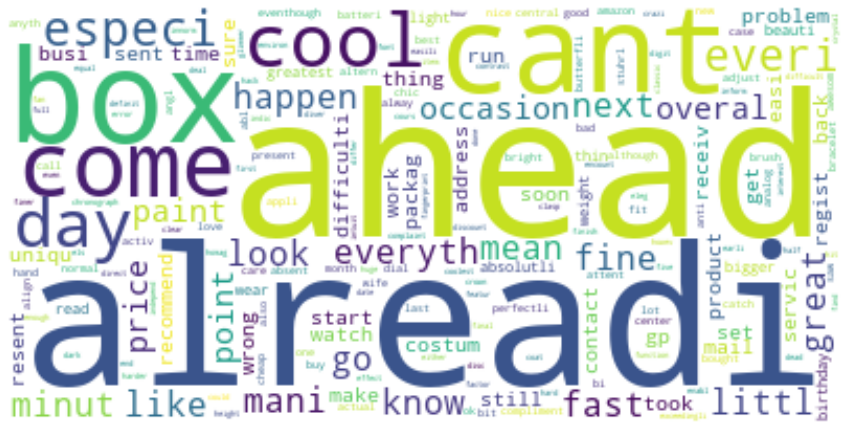

In [21]:
wordcloud = WordCloud(background_color='white').fit_words(frequencies_review)

fig, ax = plt.subplots(figsize=(15,15))
_ = ax.imshow(wordcloud, interpolation='bilinear')
_ = ax.axis("off")
fig.savefig("countvect_wordcloud.png", bbox_inches = 'tight', pad_inches = 0)

### 3.2 TfIdf Vectorizer

This works in a different way when compared to the count vectorizer, it gives more weightage to the words whcih are seen less in the document making it an important word.

2D matrix is generated in a similar way to the count vectorizer where column_names and index remain same but the values ranges between 0 and 1 instead of 0 or 1.

In [22]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(clean_review)
column_names = vectorizer.get_feature_names()
df1 = pd.DataFrame(X.toarray(), columns = column_names, index = clean_review)
df1

,aa,aabout,aacut,aato,abandon,abbrevi,abc,abid,abil,abit,...,zippo,zirconia,zize,zombi,zon,zone,zoo,zootsuit,zuedel,zulu
great look watch uniqu mani problem especi price point cant go wrong thing like know happen run littl fast mean set time soon took box next day alreadi minut ahead occasion everi cool paint start come everyth still work fine overal recommend,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
great costum servic difficulti get packag sent address regist gp mail product back contact resent make sure receiv busi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
greatest watch light weight easi read thin wear,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
receiv stuhrl watch wife birthday present nice beauti look good hand eventhough dial bigger normal perfectli fit lot compliment last one month absolutli love,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
saw watch great price like bought get new batteri ok,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
good watch band special tool chang difficult finger larg struggl quick took minut least complet look brand new way timex year old batteri,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
love uniqu design see mani like even keep time gray blacvk go well outfit,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
bought year old son one seem rug cartoon theme water resist meter taken inevit fall bicycl footbal hit frisbe basebal casual toss around boy well get idea believ money save action hero licens gone make better watch like adult style dad real also realli velcro band found roll leather tip match curv wrist help end stick smallish near case thu catch thing look price batteri replac necessari unless stop restor trust timex time,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
watch look overal bad seriou object put arrow comfort conveni time lamb small lot le cheap import sweat hand today work hour stage concert led dial becam turbid see anyth chaskh accumul condens worth zheneg price clearli high best option pleas save money,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


cosine_similarity is used in finding the similarity for 1 sentence against all the others.

In [23]:
cosine_similarity(df1)

array([[1.        , 0.00846712, 0.00527003, ..., 0.03051717, 0.04441562,
        0.0105166 ],
       [0.00846712, 1.        , 0.        , ..., 0.01787125, 0.        ,
        0.02340331],
       [0.00527003, 0.        , 1.        , ..., 0.00312421, 0.00397347,
        0.00704869],
       ...,
       [0.03051717, 0.01787125, 0.00312421, ..., 1.        , 0.03592882,
        0.03752807],
       [0.04441562, 0.        , 0.00397347, ..., 0.03592882, 1.        ,
        0.00792925],
       [0.0105166 , 0.02340331, 0.00704869, ..., 0.03752807, 0.00792925,
        1.        ]])

Generate the frequency using the function get_feature.

In [24]:
frequencies_review = get_feature(X, column_names)
frequencies_review

{'ahead': 0.2806723131876804,
 'alreadi': 0.06655162092319111,
 'box': 0.12977721135954684,
 'cant': 0.24667802915242681,
 'come': 0.17975113991491404,
 'cool': 0.38363174522855203,
 'day': 0.1498546752172298,
 'especi': 0.3022836841024099,
 'everi': 0.2484497742931251,
 'everyth': 0.0666480004951935,
 'fast': 0.27001842993002856,
 'fine': 0.2407247800309932,
 'go': 0.20168253868770175,
 'great': 0.0699071023208515,
 'happen': 0.10594866652234938,
 'know': 0.1879192408562364,
 'like': 0.05260908416880579,
 'littl': 0.12389619182637727,
 'look': 0.10006600842490439,
 'mani': 0.23567393816858534,
 'mean': 0.052950261749326405,
 'minut': 0.20149507857214408,
 'next': 0.10054017139674533,
 'occasion': 0.15732120225922178,
 'overal': 0.11587849291874601,
 'paint': 0.32953936548393603,
 'point': 0.09866895144693784,
 'price': 0.07523646050503678,
 'problem': 0.07659103053360526,
 'recommend': 0.12512358705758045,
 'run': 0.161329221739872,
 'set': 0.1776211014206054,
 'soon': 0.1533123056027

Generate a wordcloud using the frequency dict fetched above.

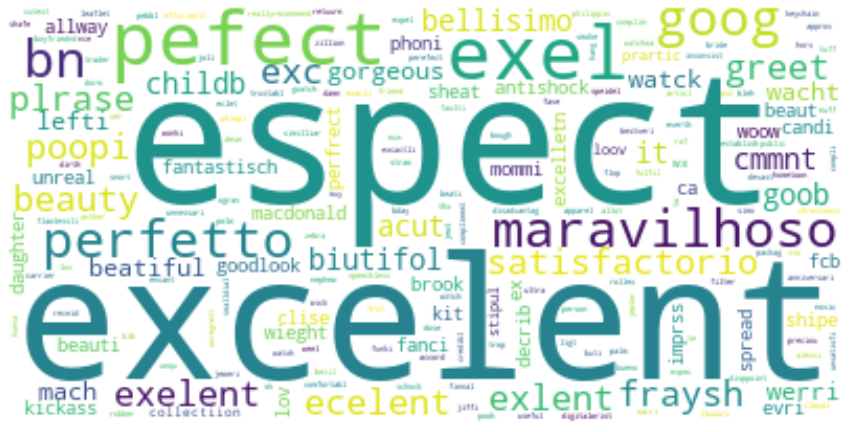

In [25]:
wordcloud = WordCloud(background_color='white').fit_words(frequencies_review)
fig, ax = plt.subplots(figsize=(15,15))
_ = ax.imshow(wordcloud, interpolation='bilinear')
_ = ax.axis("off")
fig.savefig("tfidfvect_wordcloud.png", bbox_inches = 'tight', pad_inches = 0)

### 3.3 Result

In the wordcloud using the count vectorizer we can see that the words which look big in size are not the same in the above plot, we dont see the same words with a bigger font in both plots because both works in a different perspective giving different results.

## 4.0 Plotting the wordcloud - Review Headline

Below is the same code which is run for the review_headline column, this columns has more precise words explaining the while big review in small sentences using 2 or 3 words. This column can be very useful when we train our model using Naive Bayes to classify it easily as negative and positive.

### 4.1 Count Vecotizer

In [26]:
clean_review_headline = []
for i in df_watch_new['data/review_headline']:
    clean_review_headline.append(clean_text(i))
clean_review_headline

['pretti good watch',
 'resent fix',
 'five star',
 'beauti timepiec',
 'got paid',
 'five star',
 'total awesom',
 'one star',
 'sure good one order twice',
 'origin part',
 'get pay',
 'gr watch crappi band',
 'view tip guidelin word requir',
 'thewatch pretti arriv quickli',
 'nice casual watch',
 'five star',
 'love',
 'purchas gift someon love good product',
 'mix feel',
 'citizan watch',
 'love watch',
 '',
 'five star',
 'conveni',
 'better real life',
 'watch ok kept',
 'stylish look small price',
 'good look watch',
 'stylish inexpens accur',
 'great lil gadget',
 'elvi presley woman ep classic round black polyurethan strap watch',
 'far good watch',
 'provid nice upgrad look pebbl',
 'case diamet smaller spec',
 'three star',
 'bad buy band broken',
 'great watch',
 'better store replac',
 'difficult use',
 'lumin',
 'nice watch band',
 'like',
 'nicewatch like lot',
 'ok',
 'everyth perfect',
 'beauti',
 'met exceed expect',
 'thewatch describ',
 'perfect',
 'five star',
 's

In [27]:
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(clean_review_headline)
column_names = vectorizer.get_feature_names()
df1 = pd.DataFrame(X.toarray(), columns = column_names, index = clean_review_headline)
df1

,aacut,aaron,abl,abram,abslotuley,absolut,abus,accent,accept,accessori,...,young,younger,youth,youtub,youv,yr,zebra,zirconia,zone,zoo
pretti good watch,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
resent fix,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
five star,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
beauti timepiec,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
got paid,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
timeless timex band,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
guess round watch,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
adult style kid watch,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
worth money price high,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [28]:
cosine_similarity(df1)

array([[1.        , 0.        , 0.        , ..., 0.28867513, 0.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.28867513, 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [29]:
frequencies_review_headline = get_feature(X, column_names)
frequencies_review_headline

{'good': 1,
 'pretti': 1,
 'watch': 1,
 'fix': 1,
 'resent': 1,
 'five': 1,
 'star': 1,
 'beauti': 1,
 'timepiec': 1,
 'got': 1,
 'paid': 1,
 'awesom': 1,
 'total': 1,
 'one': 1,
 'order': 1,
 'sure': 1,
 'twice': 1,
 'origin': 1,
 'part': 1,
 'get': 1,
 'pay': 1,
 'band': 1,
 'crappi': 1,
 'gr': 1,
 'guidelin': 1,
 'requir': 1,
 'tip': 1,
 'view': 1,
 'word': 1,
 'arriv': 1,
 'quickli': 1,
 'thewatch': 1,
 'casual': 1,
 'nice': 1,
 'love': 1,
 'gift': 1,
 'product': 1,
 'purchas': 1,
 'someon': 1,
 'feel': 1,
 'mix': 1,
 'citizan': 1,
 'conveni': 1,
 'better': 1,
 'life': 1,
 'real': 1,
 'kept': 1,
 'ok': 1,
 'look': 1,
 'price': 1,
 'small': 1,
 'stylish': 1,
 'accur': 1,
 'inexpens': 1,
 'gadget': 1,
 'great': 1,
 'lil': 1,
 'black': 1,
 'classic': 1,
 'elvi': 1,
 'ep': 1,
 'polyurethan': 1,
 'presley': 1,
 'round': 1,
 'strap': 1,
 'woman': 1,
 'far': 1,
 'pebbl': 1,
 'provid': 1,
 'upgrad': 1,
 'case': 1,
 'diamet': 1,
 'smaller': 1,
 'spec': 1,
 'three': 1,
 'bad': 1,
 'broken': 

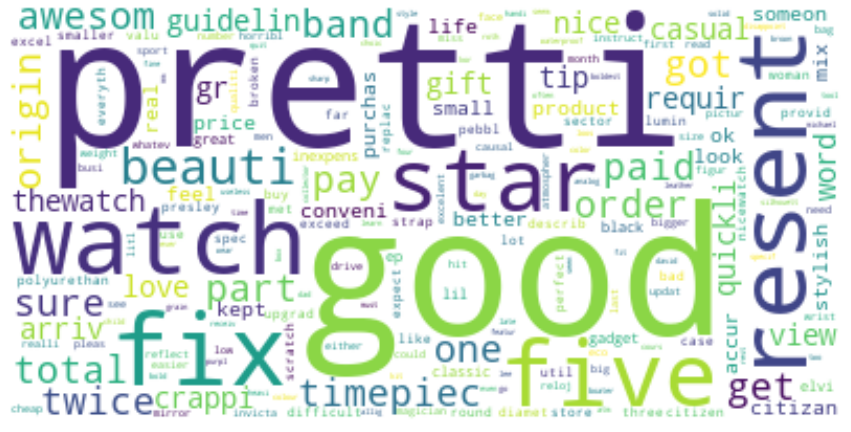

In [30]:
wordcloud = WordCloud(background_color='white').fit_words(frequencies_review_headline)
fig, ax = plt.subplots(figsize=(15,15))
_ = ax.imshow(wordcloud, interpolation='bilinear')
_ = ax.axis("off")
fig.savefig("countvect_wordcloud_headline.png", bbox_inches = 'tight', pad_inches = 0)

### 4.2 TfIdf Vectorizer

In [31]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(clean_review_headline)
column_names = vectorizer.get_feature_names()
df1 = pd.DataFrame(X.toarray(), columns = column_names, index = clean_review)
df1

,aacut,aaron,abl,abram,abslotuley,absolut,abus,accent,accept,accessori,...,young,younger,youth,youtub,youv,yr,zebra,zirconia,zone,zoo
great look watch uniqu mani problem especi price point cant go wrong thing like know happen run littl fast mean set time soon took box next day alreadi minut ahead occasion everi cool paint start come everyth still work fine overal recommend,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
great costum servic difficulti get packag sent address regist gp mail product back contact resent make sure receiv busi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
greatest watch light weight easi read thin wear,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
receiv stuhrl watch wife birthday present nice beauti look good hand eventhough dial bigger normal perfectli fit lot compliment last one month absolutli love,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
saw watch great price like bought get new batteri ok,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
good watch band special tool chang difficult finger larg struggl quick took minut least complet look brand new way timex year old batteri,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
love uniqu design see mani like even keep time gray blacvk go well outfit,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
bought year old son one seem rug cartoon theme water resist meter taken inevit fall bicycl footbal hit frisbe basebal casual toss around boy well get idea believ money save action hero licens gone make better watch like adult style dad real also realli velcro band found roll leather tip match curv wrist help end stick smallish near case thu catch thing look price batteri replac necessari unless stop restor trust timex time,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
watch look overal bad seriou object put arrow comfort conveni time lamb small lot le cheap import sweat hand today work hour stage concert led dial becam turbid see anyth chaskh accumul condens worth zheneg price clearli high best option pleas save money,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [32]:
cosine_similarity(df1)

array([[1.        , 0.        , 0.        , ..., 0.05330512, 0.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.05330512, 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [33]:
frequencies_review_headline = get_feature(X, column_names)
frequencies_review_headline

{'good': 0.5259965653172026,
 'pretti': 0.9304110288864134,
 'watch': 0.17119058666685052,
 'fix': 0.6387347530656607,
 'resent': 0.7550522669952666,
 'five': 0.7569042409199783,
 'star': 0.6535257990908632,
 'beauti': 1.0,
 'timepiec': 0.2868937948554739,
 'got': 0.4374128321475087,
 'paid': 0.6972593098731743,
 'awesom': 1.0,
 'total': 0.7034150730871325,
 'one': 0.4528255051291242,
 'order': 0.6561519951586005,
 'sure': 0.6839816515513142,
 'twice': 0.5855276782254346,
 'origin': 0.6146527092176423,
 'part': 0.504650259752221,
 'get': 0.39874410141068495,
 'pay': 0.7670060871639796,
 'band': 0.4314573777040761,
 'crappi': 1.0,
 'gr': 0.890268020468461,
 'guidelin': 0.4735764651411525,
 'requir': 0.8082688211384385,
 'tip': 0.4735764651411525,
 'view': 1.0,
 'word': 0.7806263394742801,
 'arriv': 0.49041929160796466,
 'quickli': 0.466858250427878,
 'thewatch': 0.429652035080159,
 'casual': 0.6887805110691776,
 'nice': 0.8570636425329032,
 'love': 1.0,
 'gift': 0.42934141972762685,
 'p

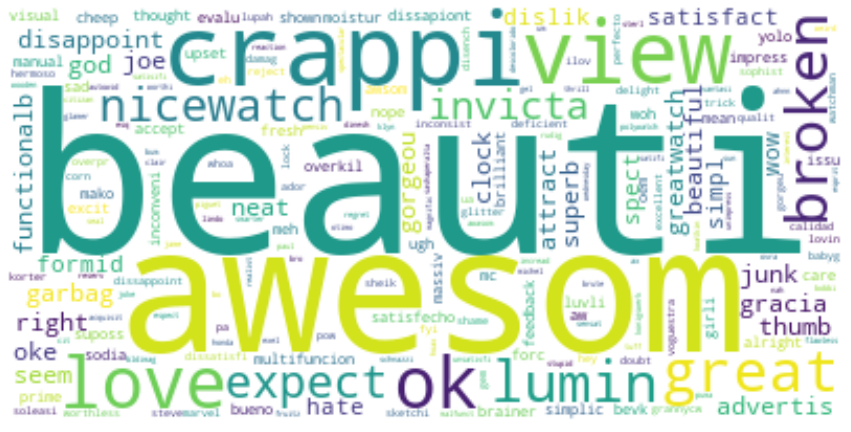

In [34]:
wordcloud = WordCloud(background_color='white').fit_words(frequencies_review_headline)
fig, ax = plt.subplots(figsize=(15,15))
_ = ax.imshow(wordcloud, interpolation='bilinear')
_ = ax.axis("off")
fig.savefig("tfidfvect_wordcloud_headline.png", bbox_inches = 'tight', pad_inches = 0)

### 4.3 Result

As we can see some good differences in both the wordclouds that different words can be seen bigger in size in both the plots.

## 5.0 Interpreting the results

The way the count vectorizer and TfIdf vectorizer works are different. The wordclouds proves that in both models different words are given more weightage. In count vectorizer the more the repeatitive word it gets more weightage but in the TfIdf vectorizer words with less frequency are given more weightage. The results of the frequencies of words can also be seen in the frequency lists fetched before the word clouds.